# Dependencies

In [2]:
!pip install seaborn

In [163]:
import pandas as pd
import matplotlib.pyplot as plt
import hvplot.pandas
import numpy as np
from sklearn import decomposition, preprocessing, cluster, tree
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.animation as animation

In [111]:
#create dataframes from csv files

peptides = pd.read_csv("PD-datasets/train_peptides.csv")
proteins = pd.read_csv("PD-datasets/train_proteins.csv")
clinical = pd.read_csv("PD-datasets/train_clinical_data.csv")

# EDA

To begin our data exploration we will look at the example of one patient in all 3 datasets. First, let's track the progression of the patient's disease as measured by Part 3 of the Unified Parkinson's Disease Rating Scale. We will focus on Part 3 because it is an objective measure of motor function taken by a specially trained doctor.

In [149]:
patients = clinical.patient_id.unique()

In [157]:
patients[:10]

array([  55,  942, 1517, 1923, 2660, 3636, 3863, 4161, 4172, 4923])

<AxesSubplot:xlabel='visit_month'>

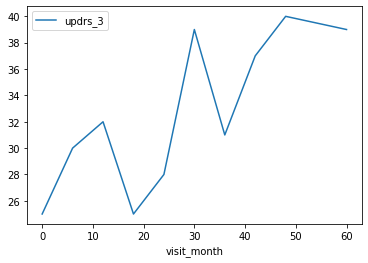

In [292]:
patient_x = clinical.loc[clinical['patient_id']==patients[2],:]
patient_x.plot(x="visit_month",y="updrs_3",kind="line")

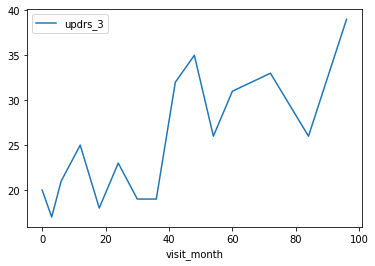

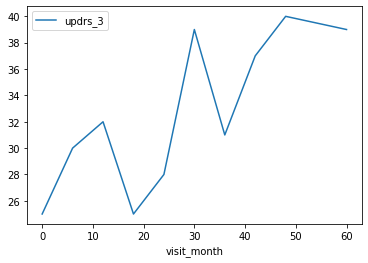

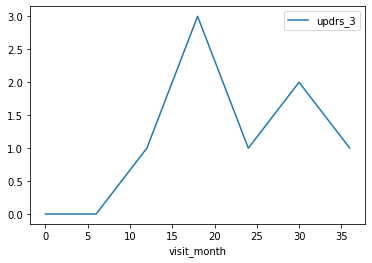

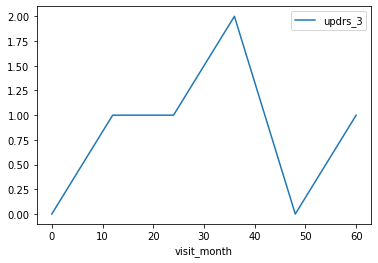

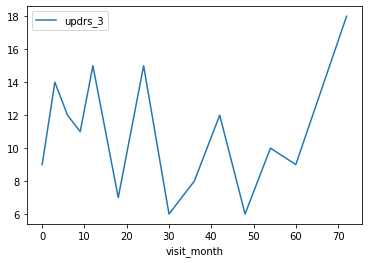

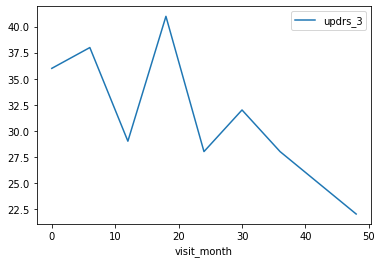

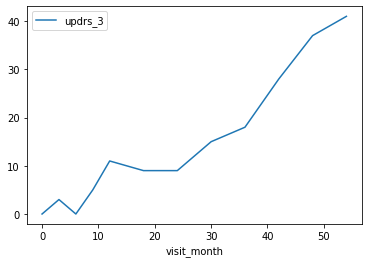

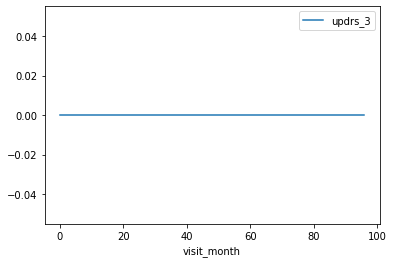

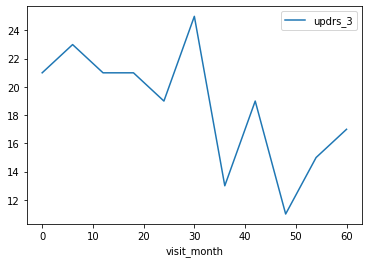

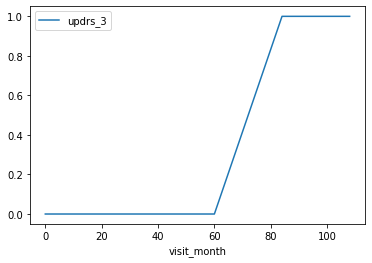

In [293]:
p = list(range(1,11))
for i in p:
    patient_x = clinical.loc[clinical['patient_id']==patients[i],:]
    patient_x.plot(x="visit_month",y="updrs_3",kind="line")

In [271]:
# p = list(range(1,11))
# for i in p:
#     patient_x = clinical.loc[clinical['patient_id']==patients[i],:]

# fig, ax = plt.subplots()

# x = patient_x["visit_month"]
# line, = ax.plot(x, patient_x["updrs_3"])


# def animate(j):
#     line.set_ydata(np.sin(x + i / 50))  # update the data.
#     return line,


# ani = animation.FuncAnimation(
#     fig, animate, interval=20, blit=True, save_count=50)

In [272]:
# # data

# x = proteins_55['visit_month']
# y = proteins_55["UniProt"]
# sizes=proteins_55["NPX"]
# colors=proteins_55["NPX"]

# # plot
# fig, ax = plt.subplots()

# ax.scatter(x, y, s=sizes, c=colors, vmin=0, vmax=100)

# ax.set(xlim=(0, 8), xticks=np.arange(1, 8),
#        ylim=(0, 8), yticks=np.arange(1, 8))

# plt.show()

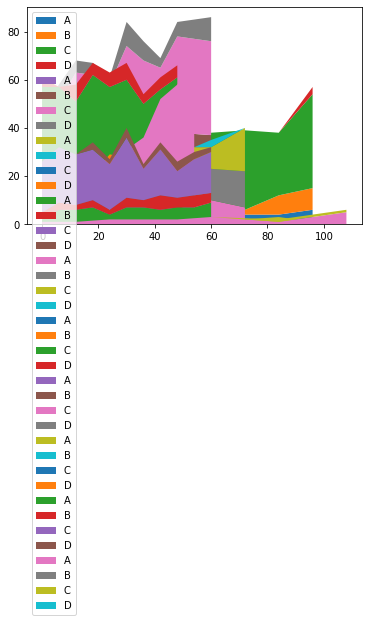

In [294]:
p = list(range(1,11))
for i in p:
    patient_x = clinical.loc[clinical['patient_id']==patients[i],:]

# Create data
    x=patient_x["visit_month"]
    y1=patient_x["updrs_1"]
    y2=patient_x["updrs_2"]
    y3=patient_x["updrs_3"]
    y4=patient_x["updrs_4"]

# Basic stacked area chart.
    plt.stackplot(x,y1, y2, y3, y4, labels=['A','B','C','D'])
    plt.legend(loc='upper left')

<AxesSubplot:xlabel='visit_month', ylabel='UniProt'>

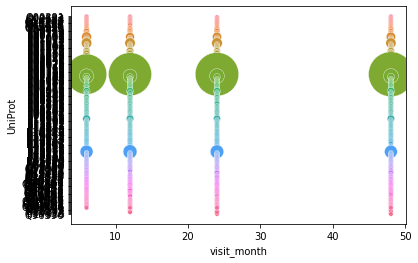

In [268]:
proteins_x = proteins.loc[proteins['patient_id']==patients[1],:]
sns.scatterplot(data=proteins_x, x="visit_month", y="UniProt", size="NPX", hue="UniProt", legend=False, sizes=(20, 2000))

<AxesSubplot:xlabel='visit_month', ylabel='Peptide'>

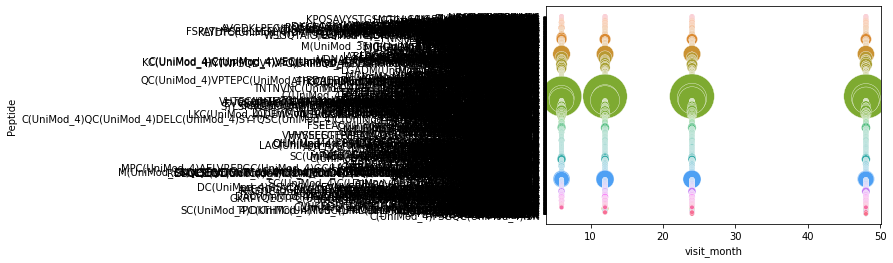

In [269]:
peptides_x = peptides.loc[peptides['patient_id']==patients[1],:]
sns.scatterplot(data=peptides_x, x="visit_month", y="Peptide", size="PeptideAbundance", hue="UniProt", legend=False, sizes=(20, 2000))

In [270]:
# patient_52998 = clinical.loc[clinical['patient_id']==52998,:]
# peptides_52998 = peptides.loc[peptides['patient_id']==52998,:]

# fig, ax1 = plt.subplots()
 
# color = 'tab:red'
# ax1.set_xlabel('X-axis')
# ax1.set_ylabel('Y1-axis', color = color)
# ax1.plot(patient_52998, patient_52998["visit_month"], patient_52998["updrs_3"], color = color)
# ax1.tick_params(axis ='y', labelcolor = color)
 
# # Adding Twin Axes to plot using dataset_2
# ax2 = ax1.twinx()
 
# color = 'tab:green'
# ax2.set_ylabel('Y2-axis', color = color)
# ax2.plot(peptides_52998, peptides_52998["visit_month"],peptides_52998["updrs_3"], color = color)
# ax2.tick_params(axis ='y', labelcolor = color)
 
# # Adding title
# plt.title('Use different y-axes on the left and right of a Matplotlib plot', fontweight ="bold")
 
# # Show plot
# plt.show()

In [8]:
#quick correlation check
peptides.corr().style.background_gradient(cmap='RdBu')

,visit_month,patient_id,UniProt,Peptide,PeptideAbundance
visit_month,1.000000,-0.018913,0.000181,0.000415,-0.001518
patient_id,-0.018913,1.000000,-0.000315,-0.000528,-0.000490
UniProt,0.000181,-0.000315,1.000000,-0.096328,-0.047631
Peptide,0.000415,-0.000528,-0.096328,1.000000,0.004136
PeptideAbundance,-0.001518,-0.000490,-0.047631,0.004136,1.000000


In [14]:
#quick correlation check
proteins.corr().style.background_gradient(cmap='RdBu')

,visit_month,patient_id,UniProt,NPX
visit_month,1.000000,-0.021398,0.000493,-0.000943
patient_id,-0.021398,1.000000,-0.001160,-0.000251
UniProt,0.000493,-0.001160,1.000000,-0.071616
NPX,-0.000943,-0.000251,-0.071616,1.000000


In [18]:
#quick correlation check
clinical.corr().style.background_gradient(cmap='RdBu')

,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
patient_id,1.000000,-0.019781,0.048258,0.037762,0.047173,-0.009203,-0.067010
visit_month,-0.019781,1.000000,0.121625,0.132308,0.135300,0.138013,-0.353447
updrs_1,0.048258,0.121625,1.000000,0.661802,0.434569,0.432620,-0.331015
updrs_2,0.037762,0.132308,0.661802,1.000000,0.735106,0.383866,-0.432432
updrs_3,0.047173,0.135300,0.434569,0.735106,1.000000,0.221593,-0.512676
updrs_4,-0.009203,0.138013,0.432620,0.383866,0.221593,1.000000,-0.169600
upd23b_clinical_state_on_medication,-0.067010,-0.353447,-0.331015,-0.432432,-0.512676,-0.169600,1.000000


# Data Cleaning

In [56]:
# def clean_visit_id(raw_visit_id):
#     chunks = raw_visit_id.split("_")
#     visitstr = chunks[1]
#     visit_id = int(visitstr)
#     return visit_id

In [73]:
# for df in [peptides, proteins, clinical]:
#     df["visit_id"] = df["visit_id"].map(clean_visit_id)

In [42]:
# #join dataframes 

# peptides_clinical = peptides.merge(clinical,how = "left", on=['visit_id', 'visit_month', 'patient_id'])
# peptides_clinical["visit_id"] = peptides_clinical["visit_id"].map(clean_visit_id)
# # proteins_clinical = proteins.merge(clinical,how = "left", on=['visit_id', 'visit_month', 'patient_id'])

In [278]:
# print(peptides_clinical.dtypes)
# print(peptides_clinical.shape)
# peptides_clinical.head(3)

In [277]:
# visits_by_patient_gb = proteins_clinical.groupby("patient_id")["visit_id"]
# first_visits = visits_by_patient_gb.min()
# last_visits = visits_by_patient_gb.max()
# last_visits

In [ ]:
# mega dataframe

# merge_df = peptides_clinical.merge(proteins,on=['visit_id', 'visit_month', 'patient_id'])

In [168]:
pep_pivot = peptides.pivot(index="visit_id",columns="Peptide",values="PeptideAbundance").sort_values(by="visit_id")

In [169]:
pro_pivot = proteins.pivot(index="visit_id",columns="UniProt",values="NPX")

In [296]:
merged_pivots = pep_pivot.merge(pro_pivot,how='left',on='visit_id')
print(merged_pivots.shape)
merged_pivots.head()

(1113, 1195)


,AADDTWEPFASGK,AAFGQGSGPIMLDEVQC(UniMod_4)TGTEASLADC(UniMod_4)K,AAFTEC(UniMod_4)C(UniMod_4)QAADK,AANEVSSADVK,AATGEC(UniMod_4)TATVGKR,AATVGSLAGQPLQER,AAVYHHFISDGVR,ADDKETC(UniMod_4)FAEEGK,ADDKETC(UniMod_4)FAEEGKK,ADDLGKGGNEESTKTGNAGSR,...,Q9HDC9,Q9NQ79,Q9NYU2,Q9UBR2,Q9UBX5,Q9UHG2,Q9UKV8,Q9UNU6,Q9Y646,Q9Y6R7
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,6580710.0,31204.4,7735070.0,NaN,NaN,NaN,46620.3,236144.0,NaN,NaN,...,NaN,9469.45,94237.6,NaN,23016.0,177983.0,65900.0,15382.0,NaN,19017.40
10053_12,6333510.0,52277.6,5394390.0,NaN,NaN,NaN,57554.5,108298.0,45885.4,NaN,...,NaN,14408.40,NaN,NaN,28537.0,171733.0,65668.1,NaN,9295.65,25697.80
10053_18,7129640.0,61522.0,7011920.0,35984.7,17188.0,19787.3,36029.4,708729.0,5067790.0,30838.2,...,317477.0,38667.20,111107.0,NaN,37932.6,245188.0,59986.1,10813.3,NaN,29102.70
10138_12,7404780.0,46107.2,10610900.0,NaN,20910.2,66662.3,55253.9,79575.5,6201210.0,26720.0,...,557904.0,44556.90,155619.0,14647.9,36927.7,229232.0,106564.0,26077.7,21441.80,7642.42
10138_24,13788300.0,56910.3,6906160.0,13785.5,11004.2,63672.7,36819.8,34160.9,2117430.0,15645.2,...,NaN,47836.70,177619.0,17061.1,25510.4,176722.0,59471.4,12639.2,15091.40,6168.55


In [297]:
mega_merge = merged_pivots.merge(clinical,how='left',on='visit_id')
print(mega_merge.shape)
mega_merge.head()

(1113, 1203)


,visit_id,AADDTWEPFASGK,AAFGQGSGPIMLDEVQC(UniMod_4)TGTEASLADC(UniMod_4)K,AAFTEC(UniMod_4)C(UniMod_4)QAADK,AANEVSSADVK,AATGEC(UniMod_4)TATVGKR,AATVGSLAGQPLQER,AAVYHHFISDGVR,ADDKETC(UniMod_4)FAEEGK,ADDKETC(UniMod_4)FAEEGKK,...,Q9UNU6,Q9Y646,Q9Y6R7,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
0,10053_0,6580710.0,31204.4,7735070.0,NaN,NaN,NaN,46620.3,236144.0,NaN,...,15382.0,NaN,19017.40,10053.0,0.0,3.0,0.0,13.0,0.0,NaN
1,10053_12,6333510.0,52277.6,5394390.0,NaN,NaN,NaN,57554.5,108298.0,45885.4,...,NaN,9295.65,25697.80,10053.0,12.0,4.0,2.0,8.0,0.0,NaN
2,10053_18,7129640.0,61522.0,7011920.0,35984.7,17188.0,19787.3,36029.4,708729.0,5067790.0,...,10813.3,NaN,29102.70,10053.0,18.0,2.0,2.0,0.0,0.0,NaN
3,10138_12,7404780.0,46107.2,10610900.0,NaN,20910.2,66662.3,55253.9,79575.5,6201210.0,...,26077.7,21441.80,7642.42,10138.0,12.0,3.0,6.0,31.0,0.0,On
4,10138_24,13788300.0,56910.3,6906160.0,13785.5,11004.2,63672.7,36819.8,34160.9,2117430.0,...,12639.2,15091.40,6168.55,10138.0,24.0,4.0,7.0,19.0,10.0,On


# Feature Engineering

In [324]:
le = LabelEncoder()
encoded_mm = mega_merge[["upd23b_clinical_state_on_medication"]].apply(le.fit_transform)
mega_merge["upd23b_clinical_state_on_medication"] = encoded_mm["upd23b_clinical_state_on_medication"]
mega_merge.head()

,visit_id,AADDTWEPFASGK,AAFGQGSGPIMLDEVQC(UniMod_4)TGTEASLADC(UniMod_4)K,AAFTEC(UniMod_4)C(UniMod_4)QAADK,AANEVSSADVK,AATGEC(UniMod_4)TATVGKR,AATVGSLAGQPLQER,AAVYHHFISDGVR,ADDKETC(UniMod_4)FAEEGK,ADDKETC(UniMod_4)FAEEGKK,...,Q9UNU6,Q9Y646,Q9Y6R7,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
0,10053_0,6580710.0,31204.4,7735070.0,NaN,NaN,NaN,46620.3,236144.0,NaN,...,15382.0,NaN,19017.40,10053.0,0.0,3.0,0.0,13.0,0.0,2
1,10053_12,6333510.0,52277.6,5394390.0,NaN,NaN,NaN,57554.5,108298.0,45885.4,...,NaN,9295.65,25697.80,10053.0,12.0,4.0,2.0,8.0,0.0,2
2,10053_18,7129640.0,61522.0,7011920.0,35984.7,17188.0,19787.3,36029.4,708729.0,5067790.0,...,10813.3,NaN,29102.70,10053.0,18.0,2.0,2.0,0.0,0.0,2
3,10138_12,7404780.0,46107.2,10610900.0,NaN,20910.2,66662.3,55253.9,79575.5,6201210.0,...,26077.7,21441.80,7642.42,10138.0,12.0,3.0,6.0,31.0,0.0,1
4,10138_24,13788300.0,56910.3,6906160.0,13785.5,11004.2,63672.7,36819.8,34160.9,2117430.0,...,12639.2,15091.40,6168.55,10138.0,24.0,4.0,7.0,19.0,10.0,1


In [325]:
clean_df = mega_merge[mega_merge.upd23b_clinical_state_on_medication != 2]
clean_df = clean_df.fillna(0)
clean_df.head()

,visit_id,AADDTWEPFASGK,AAFGQGSGPIMLDEVQC(UniMod_4)TGTEASLADC(UniMod_4)K,AAFTEC(UniMod_4)C(UniMod_4)QAADK,AANEVSSADVK,AATGEC(UniMod_4)TATVGKR,AATVGSLAGQPLQER,AAVYHHFISDGVR,ADDKETC(UniMod_4)FAEEGK,ADDKETC(UniMod_4)FAEEGKK,...,Q9UNU6,Q9Y646,Q9Y6R7,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
3,10138_12,7404780.0,46107.2,10610900.0,0.0,20910.20,66662.3,55253.9,79575.5,6201210.0,...,26077.7,21441.8,7642.42,10138.0,12.0,3.0,6.0,31.0,0.0,1
4,10138_24,13788300.0,56910.3,6906160.0,13785.5,11004.20,63672.7,36819.8,34160.9,2117430.0,...,12639.2,15091.4,6168.55,10138.0,24.0,4.0,7.0,19.0,10.0,1
5,10138_36,6924040.0,64313.5,9098610.0,26400.9,18784.60,78724.1,50155.8,508579.0,5601500.0,...,0.0,22910.5,9596.48,10138.0,36.0,5.0,2.0,11.0,0.0,1
13,10541_60,5578010.0,61435.3,4902210.0,0.0,11377.50,107775.0,40710.1,330576.0,2868310.0,...,0.0,23121.7,17482.50,10541.0,60.0,5.0,3.0,29.0,3.0,0
14,10541_84,4339140.0,18940.0,4370350.0,26725.7,8668.14,94758.2,36451.5,325450.0,2418020.0,...,0.0,16998.2,16885.90,10541.0,84.0,5.0,9.0,38.0,3.0,0


In [300]:
clean_df.corr().style.background_gradient(cmap='RdBu')

# Machine Learning

In [222]:
# constants

OUTCOME_COLUMNS = ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']
TARGET_COLUMN = OUTCOME_COLUMNS[2]

In [223]:
target_series = clean_df[TARGET_COLUMN]
features_df = clean_df.drop(columns=OUTCOME_COLUMNS)

In [245]:
# Create a list with the number of k-values from 1 to 11
k = list(range(1,11))

In [246]:
# Create an empty list to store the inertia values
inertia = []

# Create a for loop to compute the inertia with each possible value of k
# Inside the loop:
# 1. Create a KMeans model using the loop counter for the n_clusters
# 2. Fit the model to the data using `df_market_data_scaled`
# 3. Append the model.inertia_ to the inertia list

for i in k:
    k_model = KMeans(n_clusters=i,random_state=0)
    k_model.fit(features_df)
    inertia.append(k_model.inertia_)

In [247]:
# Create a dictionary with the data to plot the Elbow curve
elbow_data = {"k":k,"inertia":inertia}

# Create a DataFrame with the data to plot the Elbow curve
elbow_df = pd.DataFrame(elbow_data)

In [248]:
# Plot a line chart with all the inertia values computed with 
# the different values of k to visually identify the optimal value for k.
k_elbow = elbow_df.hvplot.line(
    x="k",
    y="inertia",
    title="Elbow",
    xticks=k,
    c="red"
)
k_elbow

:Curve   [k]   (inertia)

In [259]:
# Initialize the K-Means model using the best value for k
k_model = KMeans(n_clusters=3,random_state=0)

In [260]:
# Fit the K-Means model using the scaled data
k_model.fit(features_df)

KMeans(n_clusters=3, random_state=0)

In [261]:
# Predict the clusters to group the cryptocurrencies using the scaled data
k_predictions = k_model.predict(features_df)

# # Print the resulting array of cluster values.
# print(k_predictions)

In [262]:
# Create a copy of the DataFrame
predictions_df = features_df.copy()

In [263]:
# Add a new column to the DataFrame with the predicted clusters
predictions_df["cluster"] = k_predictions

# Display sample data
predictions_df.head()

,visit_id,AADDTWEPFASGK,AAFGQGSGPIMLDEVQC(UniMod_4)TGTEASLADC(UniMod_4)K,AAFTEC(UniMod_4)C(UniMod_4)QAADK,AANEVSSADVK,AATGEC(UniMod_4)TATVGKR,AATVGSLAGQPLQER,AAVYHHFISDGVR,ADDKETC(UniMod_4)FAEEGK,ADDKETC(UniMod_4)FAEEGKK,...,Q9UBX5,Q9UHG2,Q9UKV8,Q9UNU6,Q9Y646,Q9Y6R7,patient_id,visit_month,upd23b_clinical_state_on_medication,cluster
3,10138_12,7404780.0,46107.2,10610900.0,0.0,20910.20,66662.3,55253.9,79575.5,6201210.0,...,36927.7,229232.0,106564.0,26077.7,21441.8,7642.42,10138.0,12.0,1,1
4,10138_24,13788300.0,56910.3,6906160.0,13785.5,11004.20,63672.7,36819.8,34160.9,2117430.0,...,25510.4,176722.0,59471.4,12639.2,15091.4,6168.55,10138.0,24.0,1,1
5,10138_36,6924040.0,64313.5,9098610.0,26400.9,18784.60,78724.1,50155.8,508579.0,5601500.0,...,37860.5,206682.0,95382.6,0.0,22910.5,9596.48,10138.0,36.0,1,0
13,10541_60,5578010.0,61435.3,4902210.0,0.0,11377.50,107775.0,40710.1,330576.0,2868310.0,...,43264.3,301286.0,51668.6,0.0,23121.7,17482.50,10541.0,60.0,0,2
14,10541_84,4339140.0,18940.0,4370350.0,26725.7,8668.14,94758.2,36451.5,325450.0,2418020.0,...,40303.2,261300.0,0.0,0.0,16998.2,16885.90,10541.0,84.0,0,2


In [301]:
# Create a scatter plot using hvPlot
k_clusters = predictions_df.hvplot.scatter(
    x="visit_month",
    y="patient_id",
    c="cluster",
    hover_cols="patient_id")
k_clusters

:Scatter   [visit_month]   (patient_id,cluster)

In [256]:
# PCA

X = features_df
std = preprocessing.StandardScaler()
X_std = pd.DataFrame(std.fit_transform(X), columns=X.columns)
X_std

,visit_id,AADDTWEPFASGK,AAFGQGSGPIMLDEVQC(UniMod_4)TGTEASLADC(UniMod_4)K,AAFTEC(UniMod_4)C(UniMod_4)QAADK,AANEVSSADVK,AATGEC(UniMod_4)TATVGKR,AATVGSLAGQPLQER,AAVYHHFISDGVR,ADDKETC(UniMod_4)FAEEGK,ADDKETC(UniMod_4)FAEEGKK,...,Q9UBR2,Q9UBX5,Q9UHG2,Q9UKV8,Q9UNU6,Q9Y646,Q9Y6R7,patient_id,visit_month,upd23b_clinical_state_on_medication
0,-0.715157,-0.002451,0.036519,1.054232,-1.380627,1.573670,0.204791,1.086753,-1.092202,0.963441,...,0.239054,0.176821,0.148145,1.386508,1.238565,0.455065,-0.885271,-1.266351,-1.085190,0.986813
1,-0.715153,1.605506,0.577149,-0.305314,-0.501791,0.139665,0.141136,-0.244160,-1.318235,-1.088460,...,0.600193,-0.631700,-0.417195,0.067888,-0.047678,-0.351772,-0.996078,-1.266351,-0.519765,0.986813
2,-0.715149,-0.123546,0.947635,0.499260,0.302451,1.265966,0.461613,0.718678,1.042989,0.662116,...,0.057766,0.242878,-0.094636,1.073422,-1.257417,0.641668,-0.738363,-1.266351,0.045659,0.986813
3,-0.702174,-0.462600,0.803598,-1.040713,-1.380627,0.193705,1.080170,0.036713,0.157051,-0.711179,...,0.335744,0.625550,0.923903,-0.150595,-1.257417,0.668501,-0.145483,-1.244415,1.176509,-1.013364
4,-0.702166,-0.774661,-1.323036,-1.235893,0.323158,-0.198506,0.803014,-0.270751,0.131539,-0.937428,...,-1.953030,0.415859,0.493400,-1.597345,-1.257417,-0.109507,-0.190336,-1.244415,2.307358,-1.013364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,-0.772879,-0.040336,-0.281931,0.164289,-0.155120,1.092860,-0.979699,-0.277205,1.017611,1.082387,...,-0.352475,-0.480898,-1.051042,1.032435,-0.058340,-0.486956,0.012337,-1.364002,-0.519765,-1.013364
448,-0.772869,-0.582780,0.534997,-0.285186,-0.248432,0.880134,-0.337061,-0.258896,0.207753,0.484414,...,-0.061971,-0.832858,-0.940999,1.164189,-0.090692,-0.292349,0.586599,-1.364002,0.893796,0.986813
449,-1.013383,0.362878,0.138874,1.371042,-0.166410,0.281864,-0.655047,0.238869,1.146175,0.472506,...,-0.574546,-0.835415,-1.035905,1.117582,0.155665,1.189901,-1.014812,-1.344678,-1.650615,0.986813
450,-0.761460,-0.273258,-0.125168,1.338638,-0.477833,0.616263,-0.657272,-0.492862,0.308475,0.157886,...,-0.582570,-1.248580,-1.311252,0.559575,-0.112294,-0.565195,-0.863123,-1.344678,-1.085190,0.986813


In [280]:
features_df.head()

,visit_id,AADDTWEPFASGK,AAFGQGSGPIMLDEVQC(UniMod_4)TGTEASLADC(UniMod_4)K,AAFTEC(UniMod_4)C(UniMod_4)QAADK,AANEVSSADVK,AATGEC(UniMod_4)TATVGKR,AATVGSLAGQPLQER,AAVYHHFISDGVR,ADDKETC(UniMod_4)FAEEGK,ADDKETC(UniMod_4)FAEEGKK,...,Q9UBR2,Q9UBX5,Q9UHG2,Q9UKV8,Q9UNU6,Q9Y646,Q9Y6R7,patient_id,visit_month,upd23b_clinical_state_on_medication
3,10138_12,7404780.0,46107.2,10610900.0,0.0,20910.20,66662.3,55253.9,79575.5,6201210.0,...,14647.9,36927.7,229232.0,106564.0,26077.7,21441.8,7642.42,10138.0,12.0,1
4,10138_24,13788300.0,56910.3,6906160.0,13785.5,11004.20,63672.7,36819.8,34160.9,2117430.0,...,17061.1,25510.4,176722.0,59471.4,12639.2,15091.4,6168.55,10138.0,24.0,1
5,10138_36,6924040.0,64313.5,9098610.0,26400.9,18784.60,78724.1,50155.8,508579.0,5601500.0,...,13436.5,37860.5,206682.0,95382.6,0.0,22910.5,9596.48,10138.0,36.0,1
13,10541_60,5578010.0,61435.3,4902210.0,0.0,11377.50,107775.0,40710.1,330576.0,2868310.0,...,15294.0,43264.3,301286.0,51668.6,0.0,23121.7,17482.50,10541.0,60.0,0
14,10541_84,4339140.0,18940.0,4370350.0,26725.7,8668.14,94758.2,36451.5,325450.0,2418020.0,...,0.0,40303.2,261300.0,0.0,0.0,16998.2,16885.90,10541.0,84.0,0


In [305]:
pca = decomposition.PCA()
pca_X = pd.DataFrame(pca.fit_transform(X_std))
pca_X

,0,1,2,3,4,5,6,7,8,9,...,442,443,444,445,446,447,448,449,450,451
0,-10.877563,-20.863588,5.330140,2.822028,-4.577785,0.005904,-3.332799,-6.469190,-8.595429,-5.509104,...,0.055763,0.041930,0.335759,0.390532,-0.344012,-0.224856,0.014023,0.119532,-0.014090,7.785129e-16
1,-3.203898,-4.353881,-6.255672,7.791146,5.961694,8.900131,-1.772707,-5.241874,-5.449889,5.016388,...,-0.011076,-0.089173,0.052244,-0.131223,0.111316,0.033543,-0.015913,0.076291,-0.093018,7.785129e-16
2,-9.728092,-17.085655,-1.656582,0.927227,-1.458680,-1.295543,-1.228610,-6.258476,-7.160439,-0.412952,...,-0.206643,-0.021105,-0.165599,-0.362704,0.474773,0.271314,-0.027476,0.089216,0.184332,7.785129e-16
3,-15.213030,-0.055359,-12.013736,-7.845770,-1.303710,-0.091138,4.561002,4.349988,5.527958,3.239744,...,0.208478,0.144985,0.000974,0.042872,0.155429,-0.224807,-0.225495,0.192336,0.175977,7.785129e-16
4,-4.881930,5.436627,-10.464962,-7.517132,-4.243511,-2.882372,2.859139,5.585228,5.403637,4.032591,...,-0.463674,-0.140851,0.376116,-0.109502,0.127973,0.120762,0.202935,-0.380707,0.107636,7.785129e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,18.454982,-8.418502,6.242024,4.616221,3.998149,-3.704962,-1.443734,-2.631072,1.303981,4.631125,...,-0.027130,-0.061377,-0.409589,0.192979,-0.057431,0.174546,0.077363,-0.001564,0.066720,7.785129e-16
448,13.975130,-15.041513,-3.712941,1.185532,0.062765,-1.563357,1.832199,0.158642,-1.934339,1.219094,...,0.227486,0.253821,0.140959,-0.225206,-0.139200,0.065018,0.017601,-0.246174,-0.000935,7.785129e-16
449,4.669908,-13.161349,-3.141359,1.304374,-6.563664,1.316785,-3.910957,-5.677682,-3.433380,1.193932,...,0.034234,0.290245,0.199431,0.034537,-0.116008,0.013616,0.040193,-0.157107,0.118659,7.785129e-16
450,16.615776,-16.573641,-1.025426,-1.173641,-7.739689,-2.948786,-0.160890,-2.892120,-4.119501,-2.507631,...,-0.227860,-0.033642,0.035885,-0.199728,0.002707,-0.199053,-0.073887,0.062136,-0.108242,7.785129e-16


In [302]:
pca.components_[0]

array([-0.00034073, -0.01775386, -0.02411962, ..., -0.00167686,
       -0.00183382,  0.00409582])

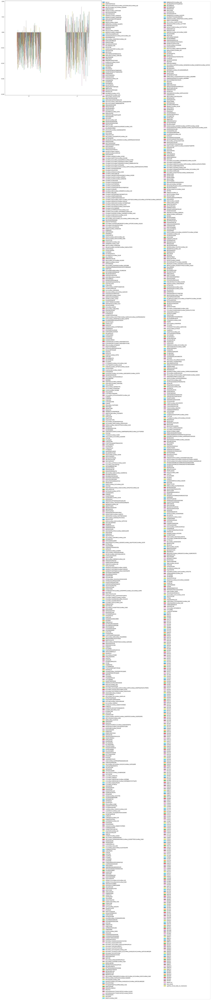

In [303]:
(pd.DataFrame(pca.components_, columns=X.columns)
.iloc[:2]
 .plot.bar(figsize=(16,16))
 .legend(ncol=(2),bbox_to_anchor=(1,1)))

<AxesSubplot:xlabel='0', ylabel='1'>

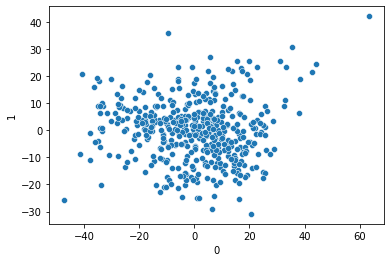

In [307]:
sns.scatterplot(x=pca_X[0],y=pca_X[1],
                data=pca_X)

# More ML

In [327]:
# Separate the data into labels and features

# Separate the y variable, the labels
y = clean_df["updrs_3"].values.reshape(-1,1)

# Separate the X variable, the features
Z = clean_df.copy()
Z.drop("updrs_3",axis=1, inplace=True)

In [328]:
from sklearn.model_selection import train_test_split

# Split the data using train_test_split
# Assign a random_state of 1 to the function
Z_train, Z_test, y_train, y_test = train_test_split(Z, y, random_state=1)
y_train.shape

(339, 1)

In [329]:
# Import the LogisticRegression module from SKLearn
from sklearn.linear_model import LogisticRegression

# Instantiate the Logistic Regression model
# Assign a random_state parameter of 1 to the model
lr_model = LogisticRegression(solver='lbfgs', random_state=1)

# Fit the model using training data
lr_model.fit(Z_train, y_train)

/Users/oaklandsveryown/opt/anaconda3/envs/PythonData/lib/python3.7/site-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/oaklandsveryown/opt/anaconda3/envs/PythonData/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


LogisticRegression(random_state=1)

In [330]:
lr_testing_predictions = lr_model.predict(Z_test)

In [331]:
from sklearn.metrics import balanced_accuracy_score, confusion_matrix, classification_report
# target_names = []
print(classification_report(y_test,lr_testing_predictions))

              precision    recall  f1-score   support

         1.0       0.00      0.00      0.00         1
         3.0       0.00      0.00      0.00         0
         4.0       0.00      0.00      0.00         1
         6.0       0.00      0.00      0.00         1
         7.0       0.00      0.00      0.00         1
         8.0       0.00      0.00      0.00         0
         9.0       0.00      0.00      0.00         3
        10.0       0.00      0.00      0.00         2
        11.0       0.00      0.00      0.00         3
        12.0       0.00      0.00      0.00         1
        13.0       0.00      0.00      0.00         3
        14.0       0.00      0.00      0.00         4
        15.0       0.00      0.00      0.00         3
        16.0       0.00      0.00      0.00         1
        17.0       0.00      0.00      0.00         4
        18.0       0.00      0.00      0.00         3
        19.0       0.00      0.00      0.00         6
        20.0       1.00    

/Users/oaklandsveryown/opt/anaconda3/envs/PythonData/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/oaklandsveryown/opt/anaconda3/envs/PythonData/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/oaklandsveryown/opt/anaconda3/envs/PythonData/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _w